<a href="https://colab.research.google.com/github/ahmadmasood43/Glioblastoma-Detection-and-VR-Conversion/blob/feature-1/3dmodelgeneration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

following is the code to link the colab with the google drive

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import pydicom
import numpy as np
import os
import matplotlib.pyplot as plt

dicom to mri images converting code

In [5]:
# Path to DICOM folder
dicom_folder = '/content/drive/MyDrive/SE000001'

# Path to output folder for MRIs
output_folder = '/content/drive/MyDrive/MRIsforfyp'

# Get list of DICOM file names
dicom_files = os.listdir(dicom_folder)

# Load DICOM files and convert to MRI images
for i, filename in enumerate(dicom_files):
    dicom_file = pydicom.dcmread(os.path.join(dicom_folder, filename))
    dicom_image = dicom_file.pixel_array
    mri_image = (dicom_image - np.min(dicom_image)) / (np.max(dicom_image) - np.min(dicom_image))
    
    # Save MRI image to file
    output_filename = f'mri_{i:04d}.npy'
    output_path = os.path.join(output_folder, output_filename)
    np.save(output_path, mri_image)


following is the code for checking the shape of the images. This is basically done to ensure if they are 2d images or 3d.

In [ ]:
# Path to folder containing MRI files
folder_path = '/content/drive/MyDrive/MRIsforfyp'

# Get list of MRI file paths
file_paths = sorted([os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.npy')])

# Loop over each MRI file
for file_path in file_paths:
    # Load MRI image
    mri_image = np.load(file_path)
    
    # Print shape of MRI image
    print(f'{file_path}: {mri_image.shape}')


/content/drive/MyDrive/MRIsforfyp/mri_0000.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0001.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0002.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0003.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0004.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0005.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0006.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0007.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0008.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0009.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0010.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0011.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0012.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0013.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0014.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0015.npy: (256, 256)
/content/drive/MyDrive/MRIsforfyp/mri_0016.npy: (256, 25

code to segment the brain out from brain mris

In [11]:
import os
import numpy as np
from skimage import morphology

# Path to folder containing MRI files
folder_path = '/content/drive/MyDrive/MRIsforfyp'

# Path to output folder for segmented images
output_folder_path = '/content/drive/MyDrive/segmentedimagesforfyp'


# Get list of MRI file paths
file_paths = sorted([os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.npy')])

# Loop over each MRI file
for i, file_path in enumerate(file_paths):
    # Load MRI image
    mri_image = np.load(file_path)
    
    # Threshold MRI image to segment brain
    brain_mask = mri_image > 0.20
    
    # Perform morphological opening to remove small structures
    selem = morphology.disk(10)
    brain_mask = morphology.binary_opening(brain_mask, selem)
    
    # Apply brain mask to MRI image
    brain_image = mri_image * brain_mask
    
    # Save segmented brain image to output folder
    output_path = os.path.join(output_folder_path, f'segmented_{i:04d}.npy')
    np.save(output_path, brain_image)

Following is the code to display the images from npy format...

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Path to folder containing segmented brain images
folder_path = '/content/drive/MyDrive/MRIsforfyp'

# Get list of segmented brain image file paths
file_paths = sorted([os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.startswith('segmented_')])

# Loop over each segmented brain image file
for i, file_path in enumerate(file_paths):
    # Load image into NumPy array
    image = np.load(file_path)

    # Display image using Matplotlib
    plt.imshow(image, cmap='gray')
    plt.title(f'Segmented Brain Image {i+1}')
    plt.show()
    %matplotlib inline

if you dont want to get the whole folder images but only one..

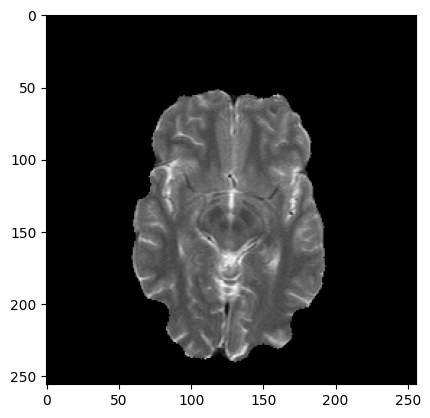

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Path to segmented brain image file
image_path = '/content/drive/MyDrive/segmentedimagesforfyp/segmented_0020.npy'

# Load image into NumPy array
image = np.load(image_path)

# Display image using Matplotlib
plt.imshow(image, cmap='gray')
plt.show()

In [12]:
import os
import numpy as np
from PIL import Image

# Path to folder containing .npy MRI files
folder_path = "/content/drive/MyDrive/segmentedimagesforfyp"

# Path to folder to save .jpg MRI files
save_folder = "/content/drive/MyDrive/npysegmentedimagesforfyp"

# Loop over each MRI file
for i, file_name in enumerate(os.listdir(folder_path)):
    if file_name.endswith(".npy"):
        # Load MRI image
        mri_image = np.load(os.path.join(folder_path, file_name))
        
        # Scale values to 0-255
        mri_image = (mri_image - np.min(mri_image)) / (np.max(mri_image) - np.min(mri_image)) * 255
        
        # Convert to uint8
        mri_image = mri_image.astype(np.uint8)
        
        # Create PIL Image object
        pil_image = Image.fromarray(mri_image)
        
        # Save as .jpg
        save_path = os.path.join(save_folder, file_name[:-4] + ".jpg")
        pil_image.save(save_path)


<ipython-input-12-62ed27bc67b6>:18: RuntimeWarning: invalid value encountered in true_divide
  mri_image = (mri_image - np.min(mri_image)) / (np.max(mri_image) - np.min(mri_image)) * 255


In [ ]:
!pip install trimesh

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 680.5/680.5 KB 13.9 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import skimage.measure
import trimesh

# Path to folder containing segmented MRI images
folder_path = "/content/drive/MyDrive/MRIsforfyp"

# Load MRI images and stack into 3D array
mri_images = []
for file_name in os.listdir(folder_path):
    if file_name.endswith(".npy"):
        mri_image = np.load(os.path.join(folder_path, file_name))
        mri_images.append(mri_image)
mri_stack = np.stack(mri_images, axis=-1)

# Generate surface mesh
vertices, faces, _, _ = skimage.measure.marching_cubes(mri_stack, level=0.5)

# Convert vertices and faces to trimesh object
mesh = trimesh.Trimesh(vertices=vertices, faces=faces)

# Save mesh as .stl
save_path = "/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.stl"
mesh.export(save_path)


In [ ]:
import trimesh

# Load STL file
mesh = trimesh.load("/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.stl")

# Save as OBJ file
mesh.export("/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.obj", file_type="obj")


'# https://github.com/mikedh/trimesh\nv 16.00000000 128.88119507 21.00000000\nv 16.00000000 129.00000000 20.96564484\nv 15.80952358 129.00000000 21.00000000\nv 16.00000000 129.00000000 21.03434563\nv 15.82178211 130.00000000 21.00000000\nv 16.00000000 130.00000000 20.94947243\nv 16.00000000 130.00000000 21.05064774\nv 16.00000000 130.18750000 21.00000000\nv 16.11320686 129.00000000 21.00000000\nv 16.10227203 130.00000000 21.00000000\nv 19.00000000 128.93534851 7.00000000\nv 19.00000000 129.00000000 6.97583294\nv 18.55882263 129.00000000 7.00000000\nv 19.00000000 129.00000000 7.02445793\nv 19.00000000 129.13888550 7.00000000\nv 19.57692337 129.00000000 7.00000000\nv 20.00000000 129.61538696 24.00000000\nv 20.00000000 130.00000000 23.96596527\nv 19.78723335 130.00000000 24.00000000\nv 20.00000000 130.00000000 24.03386307\nv 19.53246689 131.00000000 24.00000000\nv 20.00000000 131.00000000 23.88463020\nv 20.00000000 131.00000000 24.11204529\nv 19.76744080 132.00000000 24.00000000\nv 20.000

In [ ]:
!pip install pyvista

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 29.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.3/79.3 MB 8.8 MB/s eta 0:00:00


In [ ]:
dir('/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.stl')

['__add__',
 '__class__',
 '__contains__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__getnewargs__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__len__',
 '__lt__',
 '__mod__',
 '__mul__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rmod__',
 '__rmul__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 'capitalize',
 'casefold',
 'center',
 'count',
 'encode',
 'endswith',
 'expandtabs',
 'find',
 'format',
 'format_map',
 'index',
 'isalnum',
 'isalpha',
 'isascii',
 'isdecimal',
 'isdigit',
 'isidentifier',
 'islower',
 'isnumeric',
 'isprintable',
 'isspace',
 'istitle',
 'isupper',
 'join',
 'ljust',
 'lower',
 'lstrip',
 'maketrans',
 'partition',
 'removeprefix',
 'removesuffix',
 'replace',
 'rfind',
 'rindex',
 'rjust',
 'rpartition',
 'rsplit',
 'rstrip',
 'split',
 'splitlines',
 'startswith',
 'strip',
 'swapcase',


In [ ]:
help(trimesh.Trimesh.remove_duplicate_faces)

Help on function remove_duplicate_faces in module trimesh.base:

remove_duplicate_faces(self)
    On the current mesh remove any faces which are duplicates.
    
    Alters `self.faces` to remove duplicate faces



In [ ]:
import trimesh

# Load the STL file as a mesh object
mesh = trimesh.load('/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.stl')

# Calculate the mesh volume
volume = mesh.volume

# Add the volume to the mesh metadata
mesh.metadata['volume'] = volume

# Save the updated mesh to a new STL file
mesh.export('/content/drive/MyDrive/stlsegmentedimagesforfyp/brain_with_volume.stl')


In [ ]:
import trimesh

# Load the STL model
stl_model = trimesh.load('/content/drive/MyDrive/stlsegmentedimagesforfyp/mesh.stl')

# Clean the model by removing any duplicate vertices and zero area faces
stl_model = stl_model.fix_normals()
stl_model = stl_model.remove_degenerate_faces()
stl_model = stl_model.remove_duplicate_vertices()
stl_model = stl_model.remove_infinite_values()

# Optimize the mesh by simplifying it and reducing the number of triangles
stl_model = stl_model.simplify_quadratic_decimation(0.02)

# Save the cleaned and optimized STL model
stl_model.export('/content/drive/MyDrive/stlsegmentedimagesforfyp/cleaned_mesh.stl')


AttributeError: ignored

In [ ]:
!pip uninstall scikit-image
!pip install scikit-image

Found existing installation: scikit-image 0.20.0
Uninstalling scikit-image-0.20.0:
  Would remove:
    /usr/local/lib/python3.9/dist-packages/scikit_image-0.20.0.dist-info/*
    /usr/local/lib/python3.9/dist-packages/skimage/*
Proceed (Y/n)? y
  Successfully uninstalled scikit-image-0.20.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached scikit_image-0.20.0-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.2 MB)


In [ ]:

!pip install skfmm==0.20.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement skfmm==0.20.0 (from versions: none)
ERROR: No matching distribution found for skfmm==0.20.0


In [ ]:
import numpy as np
import skimage
import skimage.filters
import skimage.measure
import skimage.morphology
import scipy.ndimage
import trimesh
import os
import skfmm

# Path to folder containing MRI files
folder_path = '/content/drive/MyDrive/MRIsforfyp'
output_path = '/content/drive/MyDrive/stlsegmentedimagesforfyp/3dmesh.stl'

# Load MRI images and create 3D volume
mri_images = sorted([os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.npy')])
volume = np.stack([np.load(img_path) for img_path in mri_images])

# Preprocessing to remove noise and smooth the image
volume = scipy.ndimage.filters.median_filter(volume, size=3)
volume = skimage.filters.gaussian(volume, sigma=1)

# Threshold the volume to create a binary mask of the object
threshold = skimage.filters.threshold_otsu(volume)
mask = volume > threshold

# Morphological operations to clean up the mask
mask = skimage.morphology.binary_closing(mask, skimage.morphology.ball(3))
mask = skimage.morphology.binary_opening(mask, skimage.morphology.ball(3))

# Convert the binary mask to a surface mesh
vertices, faces, normals, values = skfmm.marching_cubes(sdf, level=0.0)

# Create a Trimesh object from the mesh data
mesh = trimesh.Trimesh(vertices=vertices, faces=faces, vertex_normals=normals)

# Save the mesh to an STL file
mesh.export(output_path)


<ipython-input-7-615575b8b3c4>:20: DeprecationWarning: Please use `median_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  volume = scipy.ndimage.filters.median_filter(volume, size=3)


AttributeError: ignored

In [ ]:
will be edited therr

SyntaxError: ignored